# Read and process GPX files info

Import needed modules

In [39]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import osmnx as ox
import h3 
import folium
import re
import io
from PIL import Image

## Initialize variables

In [40]:
strava_color = '#fc4c02'
folder = 'D:/Carlos/MyDocuments/MSc_Fisica_Avanzada_UNED/1C_Ciencia_Analisis_Datos/Final_Project/strava_history/activities/'
data_out_folder = 'data'

## Read GPX files and save info into a dataset

In [57]:
# Get the list of files in the directory
files = os.listdir(folder)

# Prepare the empty structure to read info from files
id_file = []
lat = []
lon = []
ele = []
dt = []

# Iterate over the list of files
for file in files:
  # Open the file in read mode
    f = open(folder + file, "r", encoding='utf-8')

    t0 = 0

  # Read the contents of the file and store them in the structure list
    for line in f:
        match_time = re.search(r"<time>(.+?)</time>", line)
        match_elev = re.search(r"<ele>(.+?)</ele>", line)
        if match_time:
            if t0 == 0:
                t0 = datetime.datetime.fromisoformat(match_time.group(1))
            else:
                dt.append((datetime.datetime.fromisoformat(match_time.group(1)) - t0).total_seconds())
        if match_elev:
            ele.append(float(match_elev.group(1)))
            id_file.append(file.split('.')[0])
        if "<trkpt" in line:
            line = line.split()
            lat.append(float(line[1].split('"')[1]))
            lon.append(float(line[2].split('"')[1]))
  # Close the file
    f.close()

df = pd.DataFrame(list(zip(id_file, dt, lat, lon, ele)),
                  columns = ['ID', 'dt', 'latitude', 'longitude', 'elevation'])
df.head()
df.to_csv(f'{data_out_folder}/gpx_info_processed.csv', index=False)

,ID,dt,latitude,longitude,elevation
0,1036607345,0.0,40.588942,-4.966375,1132.2
1,1036607345,39.0,40.588970,-4.966375,1132.0
2,1036607345,53.0,40.588948,-4.966353,1132.1
3,1036607345,55.0,40.588917,-4.966362,1132.1
4,1036607345,58.0,40.588878,-4.966363,1132.1


## Group geohits using h3 grid

In [150]:

# The resolution of the grid
for resolution in range(16):

    # Convert the coordinates into H3 indices
    h3_indices = [h3.geo_to_h3(lat, lon, resolution) for lat, lon in zip(df.latitude, df.longitude)]

    # Count the number of points in each cell
    counts = {}
    for index in h3_indices:
        if index in counts:
            counts[index] += 1
        else:
            counts[index] = 1

    # Convert the dictionary to a Pandas DataFrame
    h3_df = pd.DataFrame.from_dict(counts, orient='index', columns=['Count'])

    # Get the centroids of the H3 indices and add them as new columns to the DataFrame
    h3_df = h3_df.assign(centroid=h3_df.index.map(h3.h3_to_geo))
    h3_df = h3_df.assign(latitude=h3_df['centroid'].map(lambda x: x[0]))
    h3_df = h3_df.assign(longitude=h3_df['centroid'].map(lambda x: x[1]))

    # Save the dataframe to a csv file so it can be recovered easily
    h3_df.to_csv(f'{data_out_folder}/H3_grid_resolution_{resolution}.csv', index=True)
    print(f"H3 process with resolution = {resolution} has finished")

H3 process with resolution = 0 has finished
H3 process with resolution = 1 has finished
H3 process with resolution = 2 has finished
H3 process with resolution = 3 has finished
H3 process with resolution = 4 has finished
H3 process with resolution = 5 has finished
H3 process with resolution = 6 has finished
H3 process with resolution = 7 has finished
H3 process with resolution = 8 has finished
H3 process with resolution = 9 has finished
H3 process with resolution = 10 has finished
H3 process with resolution = 11 has finished
H3 process with resolution = 12 has finished
H3 process with resolution = 13 has finished
H3 process with resolution = 14 has finished
H3 process with resolution = 15 has finished


## Plot the polygons with geohits info in a map

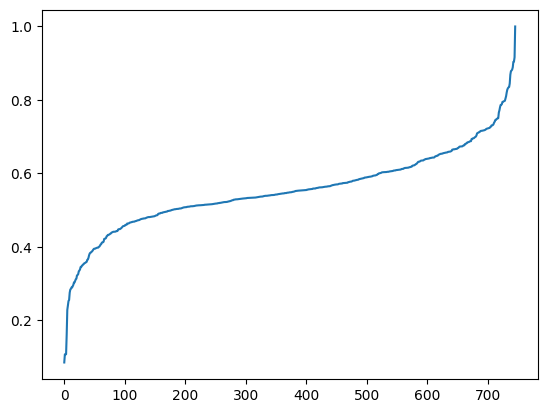

In [28]:
# Test opacity of polygons

adim = np.log(max(h3_df.Count))
adim
plt.plot(np.log(sorted(h3_df.Count))/adim)

In [3]:
h3_df = pd.read_csv(f'{data_out_folder}/H3_grid_resolution_7.csv', index_col=0)
h3_df.head()

,Count,centroid,latitude,longitude
87392a441ffffff,95069,"(40.59357943135954, -4.976041972526223)",40.593579,-4.976042
87392a46affffff,21751,"(40.61525596689377, -4.967245724351631)",40.615256,-4.967246
87392a445ffffff,59514,"(40.6108748476458, -4.995525625697317)",40.610875,-4.995526
87392a440ffffff,44858,"(40.5891932550719, -5.0043150276475075)",40.589193,-5.004315
87392a442ffffff,43953,"(40.5675081866768, -5.013099870004801)",40.567508,-5.013100


In [4]:

# Create the OpenStreetMap
m = folium.Map(location=[45.85, 9.4], zoom_start=11)
# m = folium.Map(location=[45.2, 2], zoom_start=5)

# Draw a polygon for each cell
for index, row in h3_df.iterrows():
  # Convert the H3 index into a list of coordinates
  coordinates = h3.h3_to_geo_boundary(row.name)
  # Create the polygon
  polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                           fill_opacity=(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                           name=row['Count'])
  # Add the polygon to the map
  polygon.add_to(m)

for index, row in h3_df.iterrows():
    folium.Marker(
    location=(row['latitude'],row['longitude']),
    icon=folium.DivIcon(
        icon_size=(150, 36),
        icon_anchor=(10, 6),
        html=row['Count']
    )
).add_to(m)

# Show the map
m

In [5]:
# The name of the directory
figures = 'Figures'

# Check if the directory exists
if not os.path.exists(figures):
    # Create the directory
    os.makedirs(figures)
    
resolution = 9
h3_df = pd.read_csv(f'{data_out_folder}/H3_grid_resolution_{resolution}.csv', index_col=0)
# Create the OpenStreetMap
# m = folium.Map(location=[45.85, 9.4], zoom_start=11)
m = folium.Map(location=[45.2, 2], zoom_start=5)

# Draw a polygon for each cell
for index, row in h3_df.iterrows():
  # Convert the H3 index into a list of coordinates
  coordinates = h3.h3_to_geo_boundary(row.name)
  # Create the polygon
  polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                           fill_opacity=(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                           name=row['Count'])
  # Add the polygon to the map
  polygon.add_to(m)

# Save and Show the map
m.save(f'{figures}/General_H3_map_res_{resolution}.html')
m

In [6]:
# Tests

bounds = [[45.83,9.34],[45.88,9.46]]
resolution = 9
h3_df = pd.read_csv(f'{data_out_folder}/H3_grid_resolution_{resolution}.csv', index_col=0)

# FIGURE 1 ------------------------------------------------------------
# OpenStreetMap for general view
m = folium.Map(location=[45.85, 9.4], zoom_start=resolution+4)
h3_df = h3_df.loc[(h3_df.latitude  > bounds[0][0])  &  (h3_df.latitude  < bounds [1][0]) & \
                  (h3_df.longitude > bounds[0][1])  &  (h3_df.longitude < bounds [1][1])]

# Draw a polygon for each cell
for index, row in h3_df.sort_values('Count',ascending=True).head(int(0.9*len(h3_df))).iterrows():
    # Convert the H3 index into a list of coordinates
    coordinates = h3.h3_to_geo_boundary(row.name)
    # Create the polygon
    polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                           fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                           name=row['Count'])
    # Add the polygon to the map
    polygon.add_to(m)
for index, row in h3_df.sort_values('Count',ascending=False).head(int(0.1*len(h3_df))).iterrows():
    # Convert the H3 index into a list of coordinates
    coordinates = h3.h3_to_geo_boundary(row.name)
    # Create the polygon
    polygon = folium.Polygon(locations=coordinates, color='black', fill=True, fill_color=strava_color, 
                           fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                           name=row['Count'])
    # Add the polygon to the map
    polygon.add_to(m)
    folium.Marker(
    location=(row['latitude'],row['longitude']),
    icon=folium.DivIcon(
        icon_size=(150, 36),
        icon_anchor=(10, 6),
        html=row['Count']
    )
).add_to(m)
bounds = m.get_bounds()
print(bounds)
m


[[45.82825992256698, 9.338485873809276], [45.881617812483235, 9.460397002710659]]


## Save the maps which may be of interest
### Smaller resolution: save to png

In [8]:
# The name of the directory
figures = 'Figures'

# Check if the directory exists
if not os.path.exists(figures):
    # Create the directory
    os.makedirs(figures)
    
for resolution in range(0,12):
    h3_df = pd.read_csv(f'{data_out_folder}/H3_grid_resolution_{resolution}.csv', index_col=0)
    
    # FIGURE 1 ------------------------------------------------------------
    # OpenStreetMap for general view
    m = folium.Map(location=[45.2, 2], zoom_start=5)
    # Draw a polygon for each cell
    for index, row in h3_df.iterrows():
        # Convert the H3 index into a list of coordinates
        coordinates = h3.h3_to_geo_boundary(row.name)
        # Create the polygon
        polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                               fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                               name=row['Count'])
        # Add the polygon to the map
        polygon.add_to(m)
    # Save General map
    img_data = m._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    img.save(f'{figures}/General_H3_map_res_{resolution}.png', 'PNG')
    
    # FIGURE 2 ------------------------------------------------------------
    # local openstreet map
    m = folium.Map(location=[45.85, 9.4], zoom_start=resolution+4)
    # Draw a polygon for each cell
    for index, row in h3_df.iterrows():
        # Convert the H3 index into a list of coordinates
        coordinates = h3.h3_to_geo_boundary(row.name)
        # Create the polygon
        polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                               fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                               name=row['Count'])
        # Add the polygon to the map
        polygon.add_to(m)    
    # Save zoomed map
    img_data = m._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    img.save(f'{figures}/Lecco_H3_map_res_{resolution}.png', 'PNG')
    
    # FIGURE 3 ------------------------------------------------------------
    # local openstreet map witn labels
    m = folium.Map(location=[45.85, 9.4], zoom_start=resolution+4)
    # Draw a polygon for each cell
    for index, row in h3_df.iterrows():
        # Convert the H3 index into a list of coordinates
        coordinates = h3.h3_to_geo_boundary(row.name)
        # Create the polygon
        polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                               fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                               name=row['Count'])
        # Add the polygon to the map
        polygon.add_to(m)    
    # Add labels
    for index, row in h3_df.iterrows():
        folium.Marker(
        location=(row['latitude'],row['longitude']),
        icon=folium.DivIcon(
            icon_size=(150, 36),
            icon_anchor=(10, 6),
            html=row['Count']
        )
    ).add_to(m)
    # Save map with labels
    if resolution>10:
        m.save(f'{figures}/Lecco_H3_map_res_{resolution}_labels.html')
    else:
        # Time out for very high resolution
        img_data = m._to_png(5)
        img = Image.open(io.BytesIO(img_data))
        img.save(f'{figures}/Lecco_H3_map_res_{resolution}_labels.png', 'PNG')

    print(f"H3 process with resolution = {resolution} has finished")

H3 process with resolution = 0 has finished
H3 process with resolution = 1 has finished
H3 process with resolution = 2 has finished
H3 process with resolution = 3 has finished
H3 process with resolution = 4 has finished
H3 process with resolution = 5 has finished
H3 process with resolution = 6 has finished
H3 process with resolution = 7 has finished
H3 process with resolution = 8 has finished
H3 process with resolution = 9 has finished
H3 process with resolution = 10 has finished
H3 process with resolution = 11 has finished


### Higher resolution: only local area is a matter of interest
Key: reduce info plotted as area is zoomed in: filter df

In [14]:
# The name of the directory
figures = 'Figures'

# Check if the directory exists
if not os.path.exists(figures):
    # Create the directory
    os.makedirs(figures)
    
bounds = [[45.82825992256698, 9.338485873809276], [45.881617812483235, 9.460397002710659]]

for resolution in range(10,16):
    h3_df = pd.read_csv(f'{data_out_folder}/H3_grid_resolution_{resolution}.csv', index_col=0)
    # Filter df with only H3 polygons which will appear on the map
    h3_df = h3_df.loc[(h3_df.latitude  > bounds[0][0])  &  (h3_df.latitude  < bounds [1][0]) & \
                      (h3_df.longitude > bounds[0][1])  &  (h3_df.longitude < bounds [1][1])]
    
    # FIGURE 2 ------------------------------------------------------------
    # OpenStreetMap for local view
    m = folium.Map(location=[45.85, 9.4], zoom_start=min(resolution+4,16))

    # Draw a polygon for each cell
    # Bottom 90%
    for index, row in h3_df.sort_values('Count',ascending=True).head(int(0.9*len(h3_df))).iterrows():
        # Convert the H3 index into a list of coordinates
        coordinates = h3.h3_to_geo_boundary(row.name)
        # Create the polygon
        polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                               fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                               name=row['Count'])
        # Add the polygon to the map
        polygon.add_to(m)
    # Top 10%: borders in black
    for index, row in h3_df.sort_values('Count',ascending=False).head(int(0.1*len(h3_df))).iterrows():
        # Convert the H3 index into a list of coordinates
        coordinates = h3.h3_to_geo_boundary(row.name)
        # Create the polygon
        polygon = folium.Polygon(locations=coordinates, color='black', fill=True, fill_color=strava_color, 
                               fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                               name=row['Count'])
        # Add the polygon to the map
        polygon.add_to(m)
    # Save General map
    img_data = m._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    img.save(f'{figures}/Lecco_H3_map_res_{resolution}.png', 'PNG')
    
    # FIGURE 3 ------------------------------------------------------------ 
    if resolution <= 12:
        # OpenStreetMap for local view
        m = folium.Map(location=[45.85, 9.4], zoom_start=min(resolution+4,16))

        # Draw a polygon for each cell
        # Bottom 90%
        for index, row in h3_df.sort_values('Count',ascending=True).head(int(0.9*len(h3_df))).iterrows():
            # Convert the H3 index into a list of coordinates
            coordinates = h3.h3_to_geo_boundary(row.name)
            # Create the polygon
            polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                                   fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                                   name=row['Count'])
            # Add the polygon to the map
            polygon.add_to(m)
        # Top 10%: borders in black
        for index, row in h3_df.sort_values('Count',ascending=False).head(int(0.1*len(h3_df))).iterrows():
            # Convert the H3 index into a list of coordinates
            coordinates = h3.h3_to_geo_boundary(row.name)
            # Create the polygon
            polygon = folium.Polygon(locations=coordinates, color='black', fill=True, fill_color=strava_color, 
                                   fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                                   name=row['Count'])
            # Add the polygon to the map
            polygon.add_to(m)
        # Add labels
        for index, row in h3_df.sort_values('Count',ascending=False).head(int(0.1*len(h3_df))).iterrows():
            folium.Marker(
            location=(row['latitude'],row['longitude']),
            icon=folium.DivIcon(
                icon_size=(150, 36),
                icon_anchor=(10, 6),
                html=row['Count']
            )
        ).add_to(m)

        # Save map with labels
        img_data = m._to_png(5)
        img = Image.open(io.BytesIO(img_data))
        img.save(f'{figures}/Lecco_H3_map_res_{resolution}_labels.png', 'PNG')
    
    # Update bounds to reduce area for following step
    if resolution < 12:
        bounds = m.get_bounds()
    
    print(f"H3 process with resolution = {resolution} has finished")

H3 process with resolution = 10 has finished
H3 process with resolution = 11 has finished
H3 process with resolution = 12 has finished
H3 process with resolution = 13 has finished
H3 process with resolution = 14 has finished
H3 process with resolution = 15 has finished


In [15]:
m.save(f'{figures}/Lecco_H3_map_res_{resolution}.html')

# Plot home locations identified

In [41]:
home_list = pd.read_csv(f'{data_out_folder}/home_locations.csv')

aux = home_list.Cluster_ID.value_counts().sort_values(ascending=False)

top_clusters = aux.head(3).index

home_list.head()

,Cluster_ID,Latitude,Longitude
0,20,45.580223,9.162532
1,18,45.520470,9.169526
2,45,45.498526,9.219926
3,45,45.495858,9.217559
4,40,45.855608,9.392992


In [64]:
# create a map object
m = folium.Map(location=[45.65,9.125], zoom_start=10)
    
for i, row in home_list[home_list.Cluster_ID == top_clusters[0]].iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']], radius=5, fill=True, fill_color='blue', fill_opacity=0.5, weight=0).add_to(m)

folium.CircleMarker([np.mean(home_list[home_list.Cluster_ID == top_clusters[0]]['Latitude']), 
                     np.mean(home_list[home_list.Cluster_ID == top_clusters[0]]['Longitude'])], 
                    radius=10, color='black', fill=True, fill_color='blue', fill_opacity=1).add_to(m)

for i, row in home_list[home_list.Cluster_ID == top_clusters[1]].iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']], radius=5, fill=True, fill_color='red', fill_opacity=0.5, weight=0).add_to(m)
  
folium.CircleMarker([np.mean(home_list[home_list.Cluster_ID == top_clusters[1]]['Latitude']), 
                     np.mean(home_list[home_list.Cluster_ID == top_clusters[1]]['Longitude'])], 
                    radius=10, color='black', fill=True, fill_color='red', fill_opacity=1).add_to(m)

for i, row in home_list[home_list.Cluster_ID == top_clusters[2]].iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']], radius=5, fill=True, fill_color='yellow', fill_opacity=0.5, weight=0).add_to(m)

folium.CircleMarker([np.mean(home_list[home_list.Cluster_ID == top_clusters[2]]['Latitude']), 
                     np.mean(home_list[home_list.Cluster_ID == top_clusters[2]]['Longitude'])], 
                    radius=10, color='black', fill=True, fill_color='yellow', fill_opacity=1).add_to(m)
    
img_data = m._to_png(5)
img = Image.open(io.BytesIO(img_data))
img.save(f'{figures}/possible_home_locations_1_folium.png', 'PNG')
m

In [70]:
# create a map object
m = folium.Map(location=[45.85,9.395], zoom_start=17)
    
for i, row in home_list[home_list.Cluster_ID == top_clusters[0]].iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']], radius=5, fill=True, fill_color='blue', fill_opacity=0.5, weight=0).add_to(m)

folium.CircleMarker([np.mean(home_list[home_list.Cluster_ID == top_clusters[0]]['Latitude']), 
                     np.mean(home_list[home_list.Cluster_ID == top_clusters[0]]['Longitude'])], 
                    radius=10, color='black', fill=True, fill_color='blue', fill_opacity=1).add_to(m)

for i, row in home_list[home_list.Cluster_ID == top_clusters[1]].iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']], radius=5, fill=True, fill_color='red', fill_opacity=0.5, weight=0).add_to(m)
  
folium.CircleMarker([np.mean(home_list[home_list.Cluster_ID == top_clusters[1]]['Latitude']), 
                     np.mean(home_list[home_list.Cluster_ID == top_clusters[1]]['Longitude'])], 
                    radius=10, color='black', fill=True, fill_color='red', fill_opacity=1).add_to(m)

img_data = m._to_png(5)
img = Image.open(io.BytesIO(img_data))
img.save(f'{figures}/possible_home_locations_2_folium.png', 'PNG')
m

In [69]:
# create a map object
m = folium.Map(location=[45.5,9.151], zoom_start=17)
    
for i, row in home_list[home_list.Cluster_ID == top_clusters[2]].iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']], radius=5, fill=True, fill_color='yellow', fill_opacity=0.5, weight=0).add_to(m)

folium.CircleMarker([np.mean(home_list[home_list.Cluster_ID == top_clusters[2]]['Latitude']), 
                     np.mean(home_list[home_list.Cluster_ID == top_clusters[2]]['Longitude'])], 
                    radius=10, color='black', fill=True, fill_color='yellow', fill_opacity=1).add_to(m)

img_data = m._to_png(5)
img = Image.open(io.BytesIO(img_data))
img.save(f'{figures}/possible_home_locations_3_folium.png', 'PNG')
m

## Anonymize home locations with H3

In [71]:

# The resolution of the grid
for resolution in range(16):

    # Convert the coordinates into H3 indices
    h3_indices = [h3.geo_to_h3(lat, lon, resolution) for lat, lon in zip(home_list.Latitude, home_list.Longitude)]

    # Count the number of points in each cell
    counts = {}
    for index in h3_indices:
        if index in counts:
            counts[index] += 1
        else:
            counts[index] = 1

    # Convert the dictionary to a Pandas DataFrame
    h3_df = pd.DataFrame.from_dict(counts, orient='index', columns=['Count'])

    # Get the centroids of the H3 indices and add them as new columns to the DataFrame
    h3_df = h3_df.assign(centroid=h3_df.index.map(h3.h3_to_geo))
    h3_df = h3_df.assign(latitude=h3_df['centroid'].map(lambda x: x[0]))
    h3_df = h3_df.assign(longitude=h3_df['centroid'].map(lambda x: x[1]))
    
    
    
    
    
    # FIGURE 1 ------------------------------------------------------------
    # local openstreet map
    m = folium.Map(location=[45.85, 9.4], zoom_start=resolution+4)
    # Draw a polygon for each cell
    for index, row in h3_df.iterrows():
        # Convert the H3 index into a list of coordinates
        coordinates = h3.h3_to_geo_boundary(row.name)
        # Create the polygon
        polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                               fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                               name=row['Count'])
        # Add the polygon to the map
        polygon.add_to(m)    
    # Save zoomed map
    img_data = m._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    img.save(f'{figures}/startend_H3_map_res_{resolution}.png', 'PNG')
    
    # FIGURE 2 ------------------------------------------------------------
    # local openstreet map witn labels
    m = folium.Map(location=[45.85, 9.4], zoom_start=resolution+4)
    # Draw a polygon for each cell
    for index, row in h3_df.iterrows():
        # Convert the H3 index into a list of coordinates
        coordinates = h3.h3_to_geo_boundary(row.name)
        # Create the polygon
        polygon = folium.Polygon(locations=coordinates, color=strava_color, fill=True, fill_color=strava_color, 
                               fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))), 
                               name=row['Count'])
        # Add the polygon to the map
        polygon.add_to(m)    
    # Add labels
    for index, row in h3_df.iterrows():
        folium.Marker(
        location=(row['latitude'],row['longitude']),
        icon=folium.DivIcon(
            icon_size=(150, 36),
            icon_anchor=(10, 6),
            html=row['Count']
        )
    ).add_to(m)
    # Save map with labels
    if resolution>10:
        m.save(f'{figures}/startend_H3_map_res_{resolution}_labels.html')
    else:
        # Time out for very high resolution
        img_data = m._to_png(5)
        img = Image.open(io.BytesIO(img_data))
        img.save(f'{figures}/startend_H3_map_res_{resolution}_labels.png', 'PNG')

C:\Users\cmore\AppData\Local\Temp\ipykernel_11532\3153414359.py:36: RuntimeWarning: invalid value encountered in scalar divide
  fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))),
C:\Users\cmore\AppData\Local\Temp\ipykernel_11532\3153414359.py:54: RuntimeWarning: invalid value encountered in scalar divide
  fill_opacity=0.9*(np.log(row['Count'])/np.log(max(h3_df.Count))),
